##  Data Preparation

In this section, I load the original dataset and extract relevant variables for visualization.  
This includes:

- **Diet group**, **Sex**, and **Age group** as categorical variables
- **GHG emissions**, **Methane emissions (CH₄)**, **Land use**, **Water scarcity**, **Eutrophication**, and **Biodiversity impact** as environmental indicators

I also encode categorical variables into numerical values (`diet_code`, `age_code`, `sex_code`)  
These will be used in the interactive plot later.

 Preview of the processed data is shown below.


In [2]:
# Import required library
import pandas as pd

# Load raw dataset
df = pd.read_csv("Results_21MAR2022_nokcaladjust.csv")

# Select only relevant columns for analysis and visualization
# Including: diet group, sex, age, and five environmental indicators + CH4 emissions
df_filtered = df[[
    "diet_group", "sex", "age_group",
    "mean_ghgs", "mean_ghgs_ch4",  # GHG emissions and methane (CH₄)
    "mean_land", "mean_watscar", "mean_eut", "mean_bio"
]].copy()

# Encode diet group into numeric values for color mapping in Plotly
diet_map = {name: i for i, name in enumerate(df_filtered["diet_group"].unique())}
df_filtered["diet_code"] = df_filtered["diet_group"].map(diet_map)

# Encode age_group and sex into numeric values for visualization axes
df_filtered["age_code"] = df_filtered["age_group"].astype("category").cat.codes
df_filtered["sex_code"] = df_filtered["sex"].astype("category").cat.codes

# Save processed data to CSV for use in visualization
df_filtered.to_csv("processed_diet_data.csv", index=False)
print("Data preparation complete. File saved as 'processed_diet_data.csv'")

# Preview the first 10 rows of the processed data
print("Preview of processed dataset (first 10 rows):")
df_filtered.head(10)

Data preparation complete. File saved as 'processed_diet_data.csv'
Preview of processed dataset (first 10 rows):


,diet_group,sex,age_group,mean_ghgs,mean_ghgs_ch4,mean_land,mean_watscar,mean_eut,mean_bio,diet_code,age_code,sex_code
0,fish,female,20-29,5.377071,1.165277,8.589807,14012.27478,23.553012,478.802638,0,0,0
1,fish,female,30-39,5.376457,1.152422,8.620238,15030.26610,23.831419,469.573862,0,1,0
2,fish,female,40-49,5.169838,1.095640,8.304831,15441.25934,23.419815,435.534050,0,2,0
3,fish,female,50-59,4.933744,0.995247,7.880759,16244.68021,23.459450,382.097727,0,3,0
4,fish,female,60-69,5.428442,1.127873,8.701867,18364.95302,25.469176,435.578230,0,4,0
5,fish,female,70-79,5.446094,1.109781,8.929224,19987.50855,25.562011,438.883661,0,5,0
6,fish,male,20-29,7.699646,1.616217,11.952164,19854.45132,33.418535,668.550915,0,0,1
7,fish,male,30-39,6.841501,1.411203,10.759273,19212.19001,30.108963,589.154718,0,1,1
8,fish,male,40-49,6.502770,1.359409,10.348030,18380.27989,28.621936,560.658972,0,2,1
9,fish,male,50-59,6.128043,1.265220,9.621960,18571.70033,27.395094,505.823752,0,3,1


##  Interactive Visualization – Parallel Coordinates Plot

This parallel coordinates plot visualizes multiple environmental impact variables across different diet groups.

Key Features:
- Each line represents one individual participant
- Lines are **colored by diet group** (vegan, veggie, meat100, etc.)
- Axes represent environmental indicators including:
  - GHG emissions
  - Methane emissions (CH₄)
  - Land use
  - Water scarcity
  - Eutrophication
  - Biodiversity impact
- The plot also includes **Sex** and **Age group** for richer analysis

 The interactive nature allows filtering, dragging, and reordering axes to support exploratory insights.


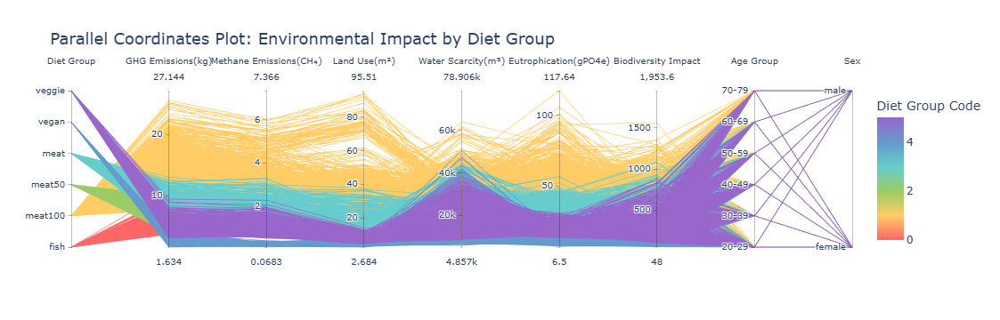

In [4]:
# Import libraries
import pandas as pd
import plotly.graph_objects as go

# Load preprocessed dataset
df_filtered = pd.read_csv("processed_diet_data.csv")

# Reconstruct diet group mapping 
diet_map = {name: i for i, name in enumerate(df_filtered["diet_group"].unique())}

# Define plot dimensions 
dimensions = [
    dict(label='Diet Group', values=df_filtered['diet_code'],
         tickvals=list(diet_map.values()), ticktext=list(diet_map.keys())),
    dict(label='GHG Emissions(kg)', values=df_filtered['mean_ghgs']),
    dict(label='Methane Emissions(CH₄)', values=df_filtered['mean_ghgs_ch4']),
    dict(label='Land Use(m²)', values=df_filtered['mean_land']),
    dict(label='Water Scarcity(m³)', values=df_filtered['mean_watscar']),
    dict(label='Eutrophication(gPO4e)', values=df_filtered['mean_eut']),
    dict(label='Biodiversity Impact', values=df_filtered['mean_bio']),
    dict(label='Age Group', values=df_filtered['age_code'],
         tickvals=list(range(len(df_filtered['age_group'].unique()))),
         ticktext=df_filtered['age_group'].unique().tolist()),
    dict(label='Sex', values=df_filtered['sex_code'],
         tickvals=[0, 1], ticktext=['female', 'male'])
]

# Create interactive parallel coordinates plot using Plotly
fig = go.Figure(data=go.Parcoords(
    line=dict(
        color=df_filtered['diet_code'],  # Color lines by diet group
        colorscale=[                      # Custom color scale based on Paletton
            [0.0, '#FF6666'],   # vegan
            [0.2, '#FFCC66'],   # veggie
            [0.4, '#99CC66'],   # fish
            [0.6, '#66CCCC'],   # meat50
            [0.8, '#6699CC'],   # meat
            [1.0, '#9966CC']    # meat100
        ],
        showscale=True,
        cmin=0,
        cmax=5,
        colorbar=dict(title='Diet Group Code')
    ),
    dimensions=dimensions
))

# Customize layout and display the plot
fig.update_layout(
    width=1125,
    title="Parallel Coordinates Plot: Environmental Impact by Diet Group",
    title_font_size=18
)

fig.show() 
fig.write_html("final_parallel_plot.html")